# Annotations using clustering for cells for lung_s3

In [1]:
slide_id = "lung_s3"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [4]:
sdata = sd.read_zarr(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/sdata_processed/sdata_lung_s3.zarr
├── Images
│     ├── 'he': DataTree[cyx] (3, 43270, 26720), (3, 21635, 13360), (3, 10818, 6680), (3, 5409, 3340), (3, 2705, 1670), (3, 1353, 835), (3, 677, 418)
│     └── 'morpho': DataTree[cyx] (5, 37348, 54086), (5, 18674, 27043), (5, 9337, 13521), (5, 4668, 6760), (5, 2334, 3380)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (275207, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (275207, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (275207, 5001)
      └── 'table_nuclei': AnnData (275207, 8584)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), morpho (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [5]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 275207 × 5001
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [6]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
0,aaaaaaaa-1,226,0,0,0,0,0,226,44.659533,21.223438,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
1,aaaaaaab-1,108,0,0,0,0,0,108,32.196407,9.889219,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaac-1,265,0,0,0,0,3,268,47.504377,25.739063,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaad-1,328,0,0,0,0,1,329,37.253908,20.636407,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
4,aaaaaaae-1,337,0,0,0,0,0,337,52.155471,27.274376,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278323,aaaeddac-1,76,0,0,0,0,0,76,41.001876,41.001876,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,7.0
278324,aaaeddad-1,12,0,0,0,0,0,12,26.416407,26.416407,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0
278325,aaaeddae-1,73,0,0,0,0,1,74,37.976408,27.545313,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0
278326,aaaeddaf-1,9,0,0,0,0,0,9,26.326095,7.857188,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0


In [7]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [8]:
adata_nuclei = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 264419 × 8584
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [9]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,19.574901,Club cell,132,1,0,5,0,T,T,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,8.737764,Neuroendocrine cell,41,1,3,2,3,Unknown,Unknown,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,24.090059,CD16 NK cell,212,1,0,5,0,T,T,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,19.079021,Memory CD4 T cell,184,1,0,5,0,T,T,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.423266,CD16 NK cell,244,1,0,5,0,T,T,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaaedcpm-1,nucleus_boundaries,morpho,aaaedcpm-1,15.510612,Neuroendocrine cell,27,4,3,9,3,Unknown,Unknown,normal_cell
aaaeddaa-1,nucleus_boundaries,morpho,aaaeddaa-1,4.040921,Neuroendocrine cell,18,2,1,0,1,Endothelial,Endothelial,normal_cell
aaaeddac-1,nucleus_boundaries,morpho,aaaeddac-1,38.586490,Goblet cell,81,4,3,9,3,Unknown,Unknown,normal_cell
aaaeddae-1,nucleus_boundaries,morpho,aaaeddae-1,25.874608,Red blood cell,76,4,7,7,7,Epithelial,Lung_epithelial_cell,cancer_cell


In [10]:
adata_nuclei.var

,mean,std
A2ML1,0.002133,0.088531
AAMP,0.206091,0.852181
AAR2,0.053621,0.433779
AARSD1,0.121247,0.622171
ABAT,0.081104,0.508079
...,...,...
ZSCAN26,0.075612,0.517679
ZSWIM6,0.075472,0.516282
ZUP1,0.066288,0.489253
ZYG11B,0.082800,0.528028


## 2. Preprocessing

<Axes: >

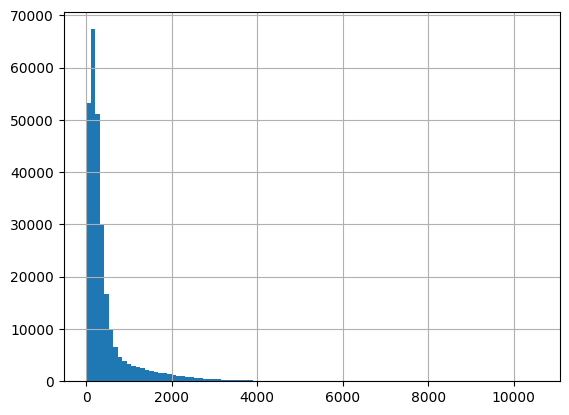

In [11]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

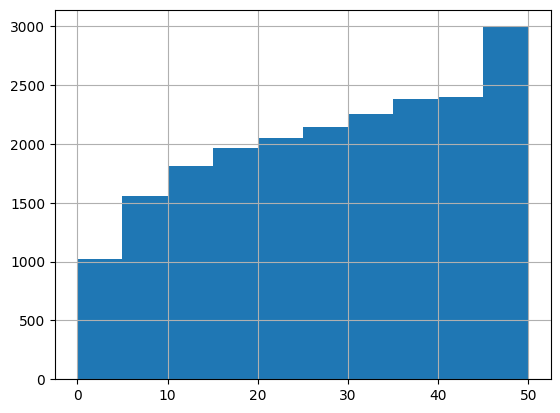

In [12]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [13]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 6368
Percentage of cells with less than 20 transcripts: 2.31%
-----
Number of cells with less than 15 transcripts: 4402
Percentage of cells with less than 15 transcripts: 1.6%
-----
Number of cells with less than 10 transcripts: 2588
Percentage of cells with less than 10 transcripts: 0.94%
-----
Number total of cells: 275207


In [14]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

272264


In [15]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [16]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [17]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [18]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


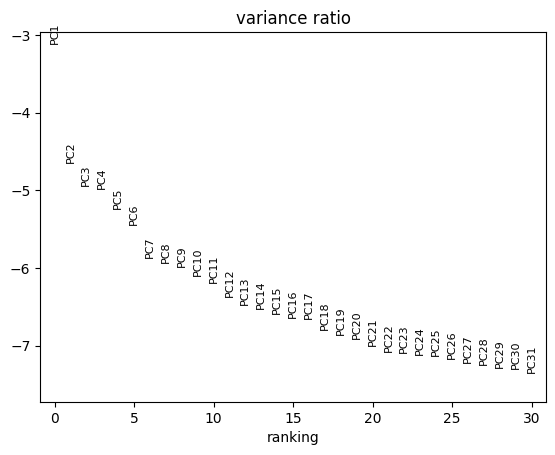

In [19]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [20]:
adata_cells

AnnData object with n_obs × n_vars = 272264 × 5001
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [21]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [22]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=20, use_rep="X_pca", key_added='pca_n10_pcs20')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs20')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs20_leiden_res0.2', neighbors_key='pca_n10_pcs20')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs20_leiden_res0.4', neighbors_key='pca_n10_pcs20')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs20_leiden_res0.6', neighbors_key='pca_n10_pcs20')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_53437/1039059012.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs20_leiden_res0.2', neighbors_key='pca_n10_pcs20')


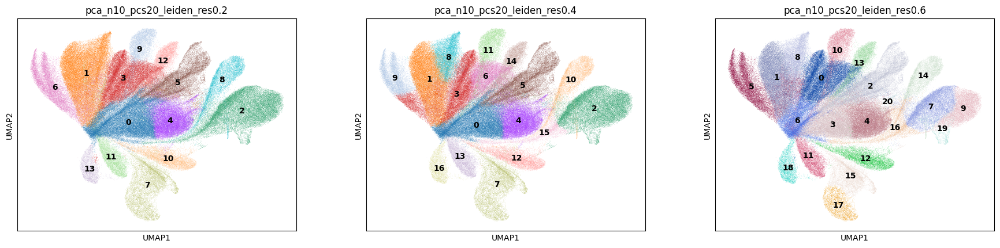

In [23]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs20',
           color=['pca_n10_pcs20_leiden_res0.2', 'pca_n10_pcs20_leiden_res0.4', 'pca_n10_pcs20_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [24]:
# Number of clusters
adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].unique()

['4', '0', '12', '2', '9', ..., '1', '7', '10', '6', '11']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [38]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.2'].isin(['13']), 'refine_res'] = '13'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.4'].isin(['6']), 'refine_res'] = '14'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs20_leiden_res0.6'].isin(['6']), 'refine_res'] = '15'

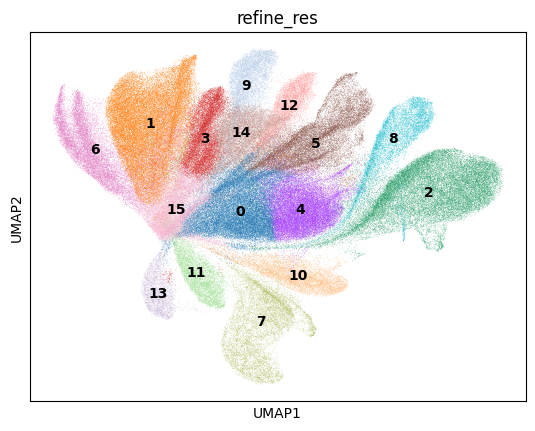

In [39]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs20', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [40]:
clustering_label = 'refine_res'

In [41]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

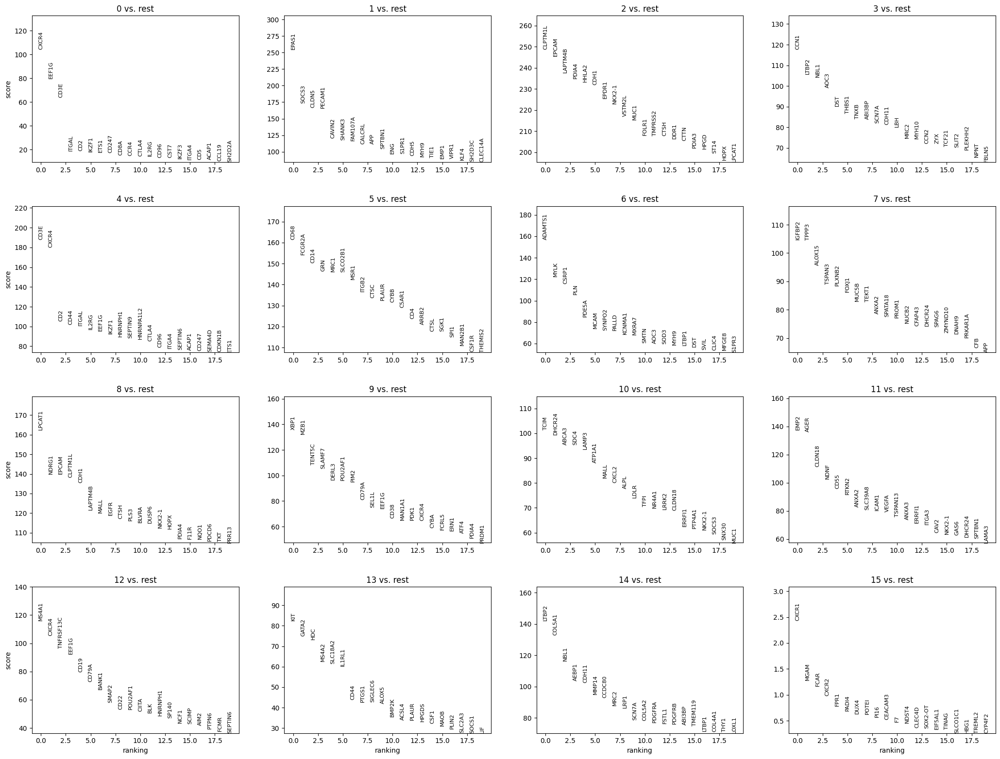

In [42]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [43]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [44]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [45]:
cluster_id = '0'

In [46]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,45.7
1,Unknown,Unknown,normal_cell,33.6
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,7.0
3,NA,NA,NA,3.6
4,B,B,normal_cell,2.6


In [47]:
top_ranked_genes[cluster_id]

0    CXCR4
1    EEF1G
2     CD3E
3    ITGAL
4      CD2
5    IKZF1
6     ETS1
Name: 0, dtype: object

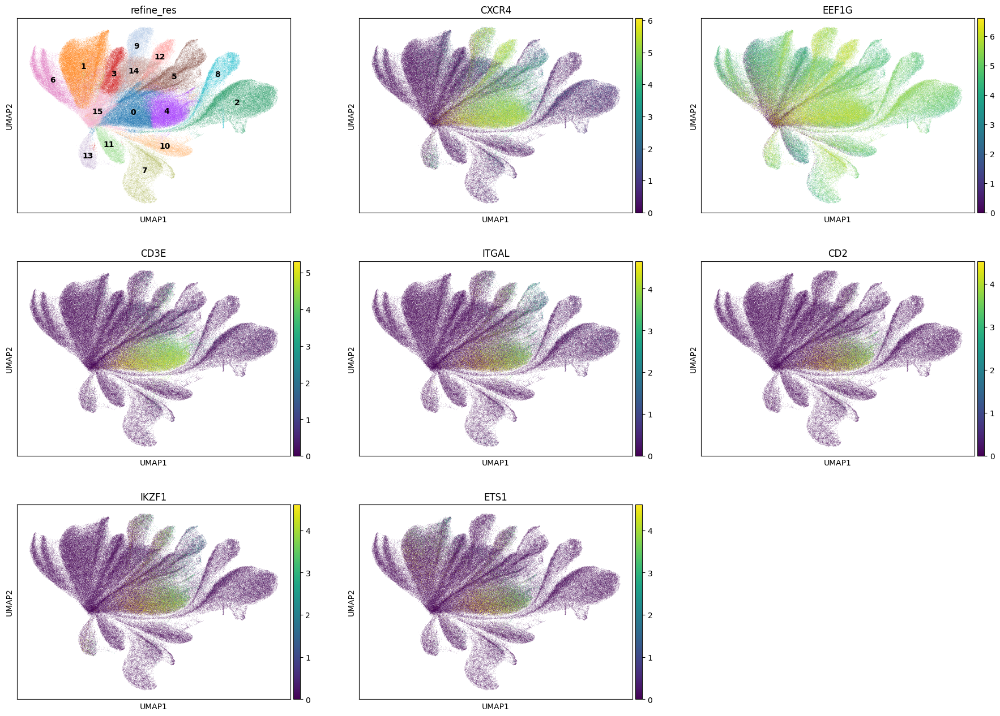

In [48]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [49]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 31967
Percentage of cells in cluster 0: 11.7


In [50]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.2. Cluster 1

In [51]:
cluster_id = '1'

In [52]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,82.5
1,Perivascular,Pericyte/Smooth_muscle,normal_cell,4.6
2,Unknown,Unknown,normal_cell,3.5
3,Fibroblast,CAF,normal_cell,3.4
4,NA,NA,NA,2.5


In [53]:
top_ranked_genes[cluster_id]

0      EPAS1
1      SOCS3
2      CLDN5
3     PECAM1
4     CAVIN2
5     SHANK3
6    FAM107A
Name: 1, dtype: object

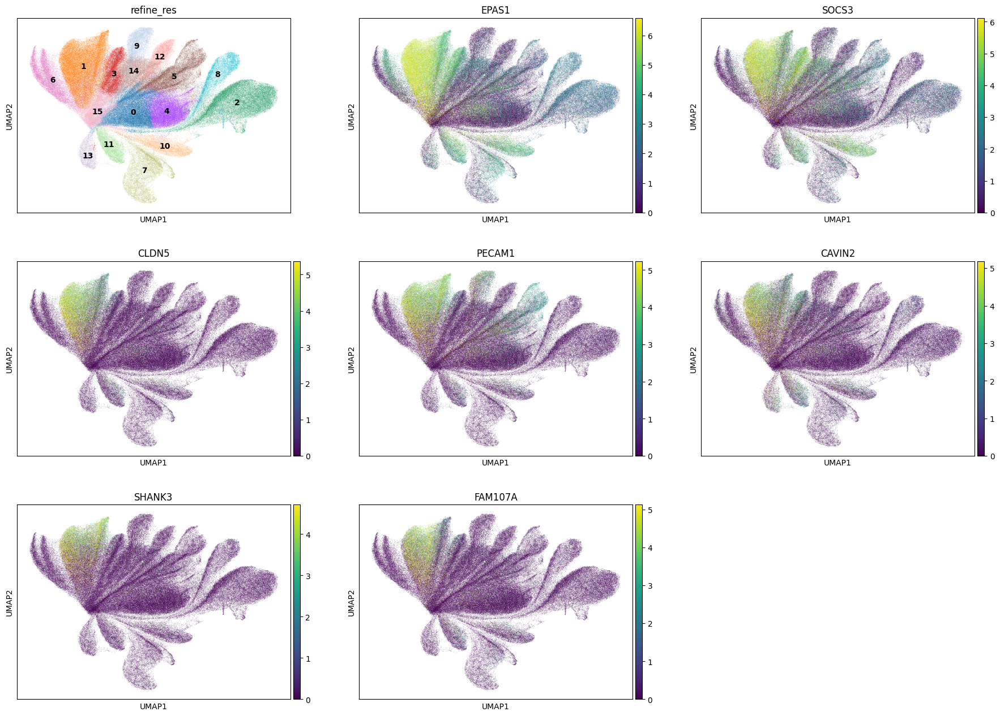

In [54]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [55]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 40266
Percentage of cells in cluster 1: 14.8


In [56]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.3. Cluster 2

In [57]:
cluster_id = '2'

In [58]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Lung_epithelial_cell,cancer_cell,94.2
1,Epithelial,Lung_proliferating_epithelial_cell,cancer_cell,2.7
2,Unknown,Unknown,normal_cell,0.8
3,T,T,normal_cell,0.7
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.6


In [59]:
top_ranked_genes[cluster_id]

0    CLPTM1L
1      EPCAM
2    LAPTM4B
3      PDIA4
4      HHLA2
5       CDH1
6      EPDR1
Name: 2, dtype: object

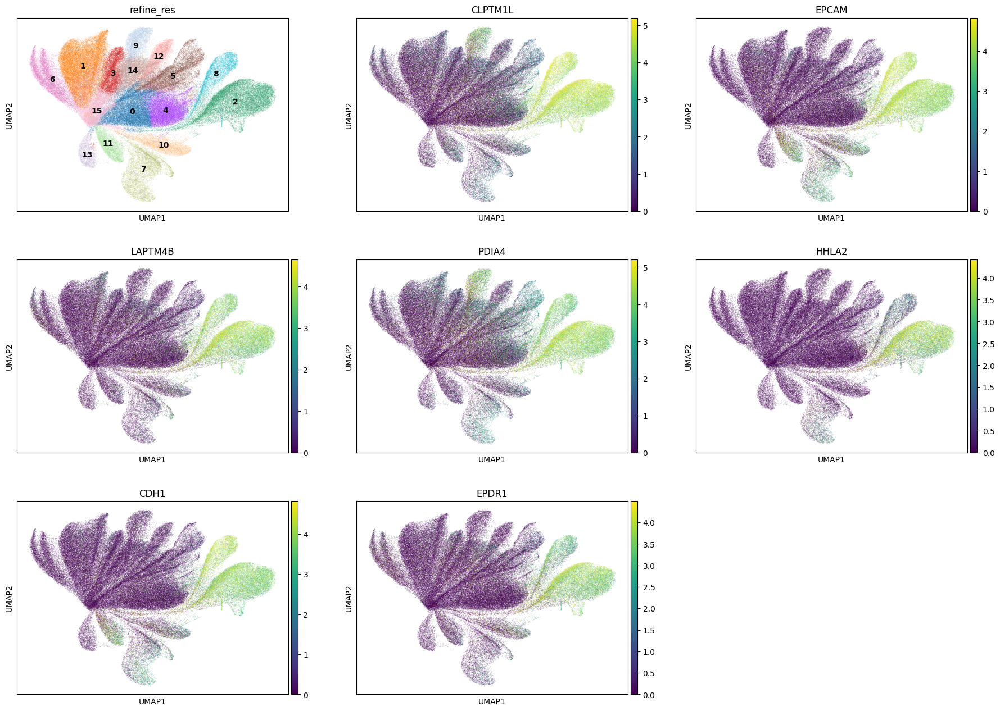

In [60]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [61]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 32007
Percentage of cells in cluster 2: 11.8


In [62]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_epithelial_cell'

### 5.4. Cluster 3

In [63]:
cluster_id = '3'

In [64]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,87.4
1,Perivascular,Pericyte/Smooth_muscle,normal_cell,4.1
2,Unknown,Unknown,normal_cell,2.2
3,Epithelial,Lung_alveolar_typeI_epithelial_cell,normal_cell,1.3
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.1


In [65]:
top_ranked_genes[cluster_id]

0     CCN1
1    LTBP2
2     NBL1
3     AOC3
4      DST
5    THBS1
6     TNXB
Name: 3, dtype: object

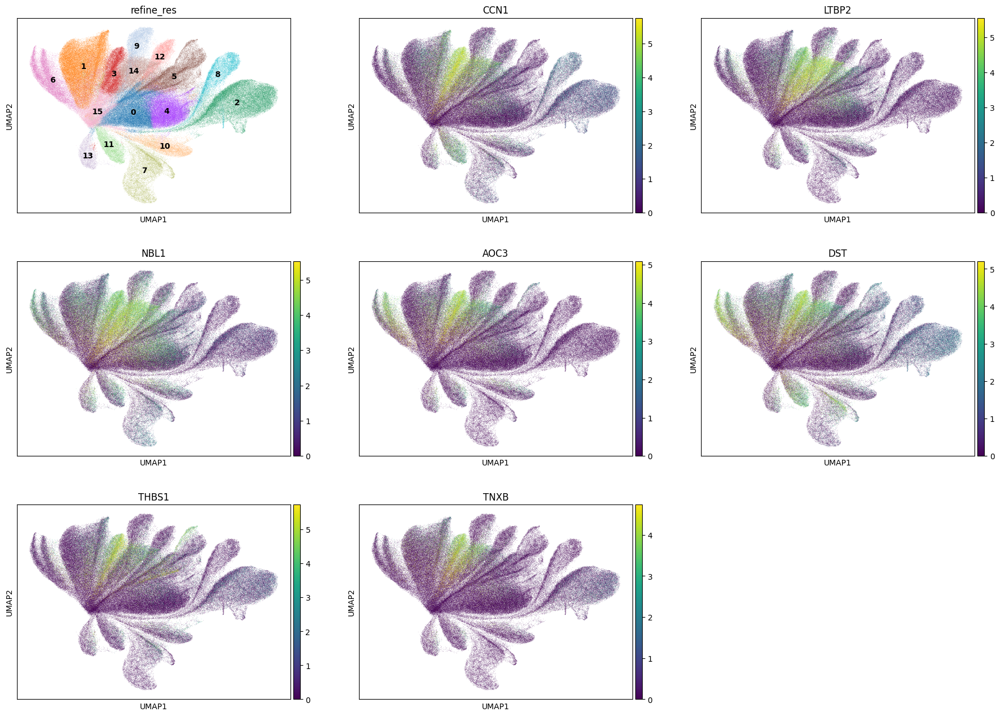

In [66]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 14772
Percentage of cells in cluster 3: 5.4


In [68]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.5. Cluster 4

In [69]:
cluster_id = '4'

In [70]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,96.1
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.2
2,Fibroblast,CAF,normal_cell,0.7
3,Epithelial,Lung_epithelial_cell,cancer_cell,0.6
4,B,B,normal_cell,0.5


In [71]:
top_ranked_genes[cluster_id]

0     CD3E
1    CXCR4
2      CD2
3     CD44
4    ITGAL
5    IL2RG
6    EEF1G
Name: 4, dtype: object

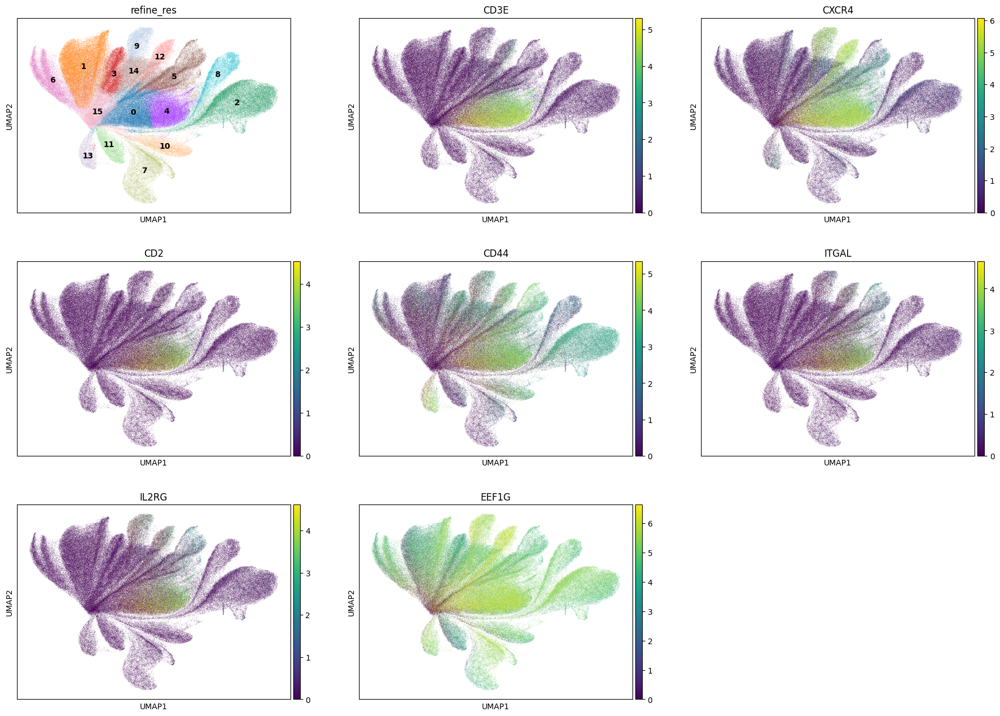

In [72]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [73]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 25595
Percentage of cells in cluster 4: 9.4


In [74]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.6. Cluster 5

In [75]:
cluster_id = '5'

In [76]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,88.9
1,Unknown,Unknown,normal_cell,5.3
2,Fibroblast,CAF,normal_cell,1.6
3,T,T,normal_cell,1.5
4,Epithelial,Lung_epithelial_cell,cancer_cell,0.7


In [77]:
top_ranked_genes[cluster_id]

0       CD68
1     FCGR2A
2       CD14
3        GRN
4       MRC1
5    SLCO2B1
6       MSR1
Name: 5, dtype: object

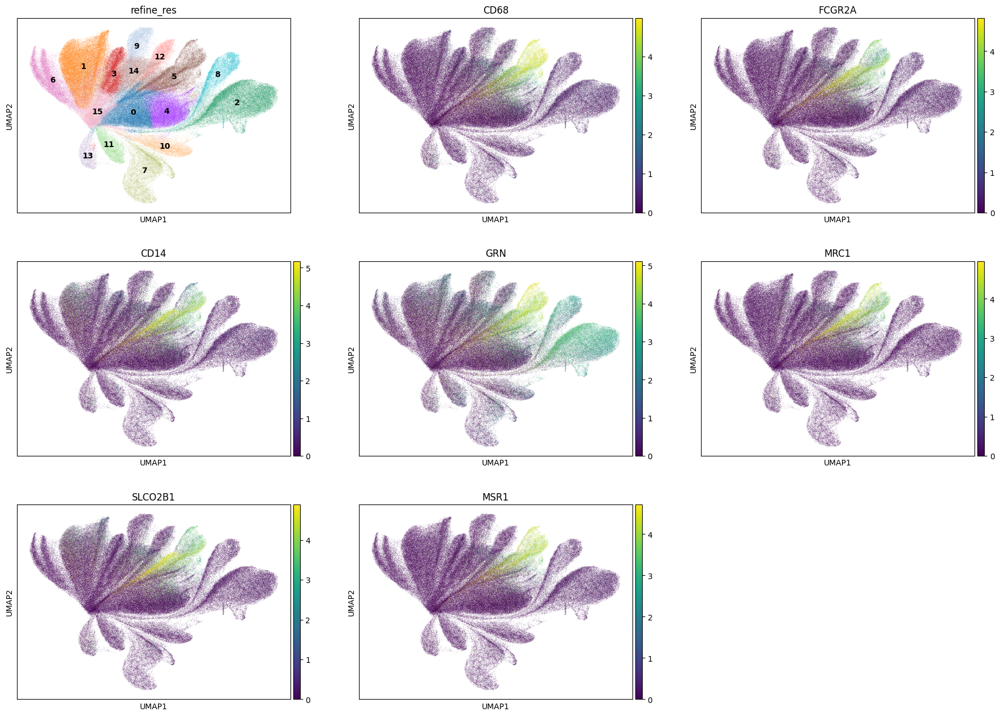

In [78]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [79]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 20450
Percentage of cells in cluster 5: 7.5


In [80]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.7. Cluster 6

In [81]:
cluster_id = '6'

In [82]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Perivascular,Pericyte/Smooth_muscle,normal_cell,88.9
1,Unknown,Unknown,normal_cell,5.9
2,NA,NA,NA,2.3
3,Fibroblast,CAF,normal_cell,2.1
4,Endothelial,Endothelial,normal_cell,0.5


In [83]:
top_ranked_genes[cluster_id]

0    ADAMTS1
1       MYLK
2      CSRP1
3        PLN
4      PDE5A
5       MCAM
6     SYNPO2
Name: 6, dtype: object

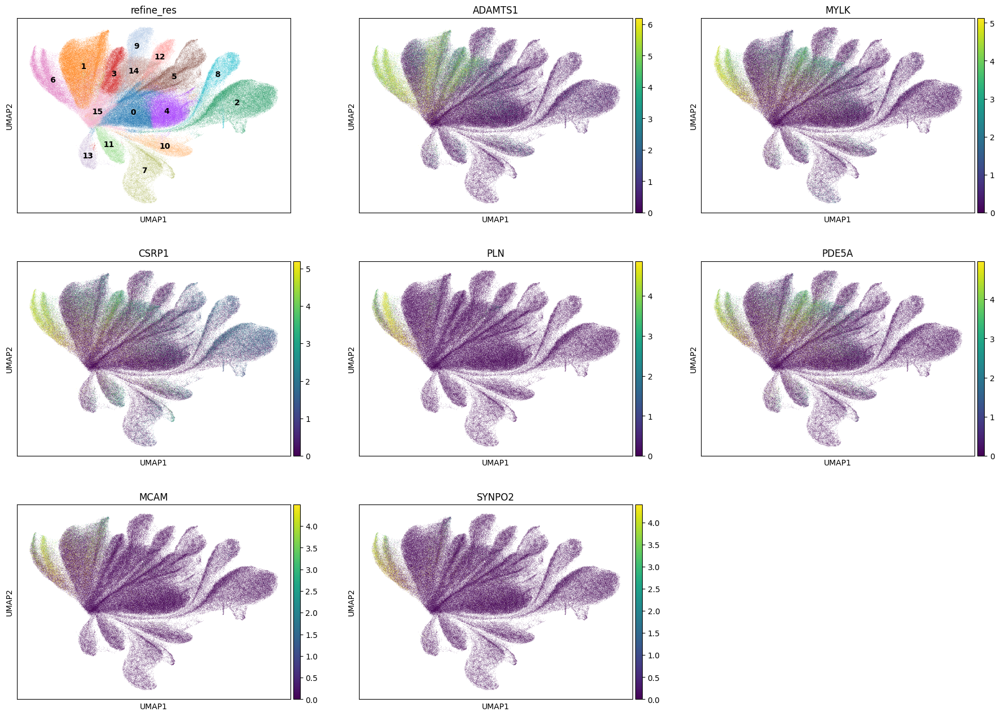

In [84]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [85]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 18493
Percentage of cells in cluster 6: 6.8


In [86]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.8. Cluster 7

In [87]:
cluster_id = '7'

In [88]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Lung_ciliated_epithelial_cell,normal_cell,92.5
1,Epithelial,Lung_epithelial_cell,cancer_cell,2.2
2,T,T,normal_cell,1.7
3,Unknown,Unknown,normal_cell,1.5
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.0


In [89]:
top_ranked_genes[cluster_id]

0    IGFBP2
1     TPPP3
2    ALOX15
3    TSPAN3
4    PLXNB2
5     FOXJ1
6     MUC5B
Name: 7, dtype: object

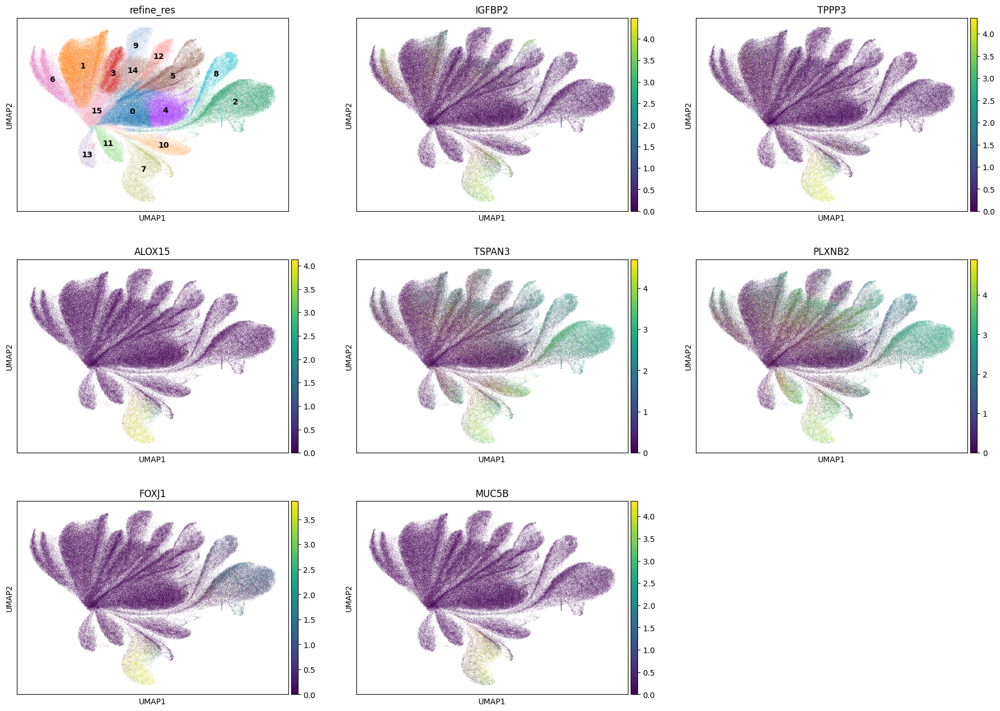

In [90]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [91]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 11562
Percentage of cells in cluster 7: 4.2


In [92]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_ciliated_epithelial_cell'

### 5.9. Cluster 8

In [93]:
cluster_id = '8'

In [94]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Lung_alveolar_typeII_epithelial_cell,cancer_cell,74.7
1,Epithelial,Lung_epithelial_cell,cancer_cell,22.1
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.1
3,Unknown,Unknown,normal_cell,0.6
4,T,T,normal_cell,0.6


In [95]:
top_ranked_genes[cluster_id]

0     LPCAT1
1      NDRG1
2      EPCAM
3    CLPTM1L
4       CDH1
5    LAPTM4B
6       MALL
Name: 8, dtype: object

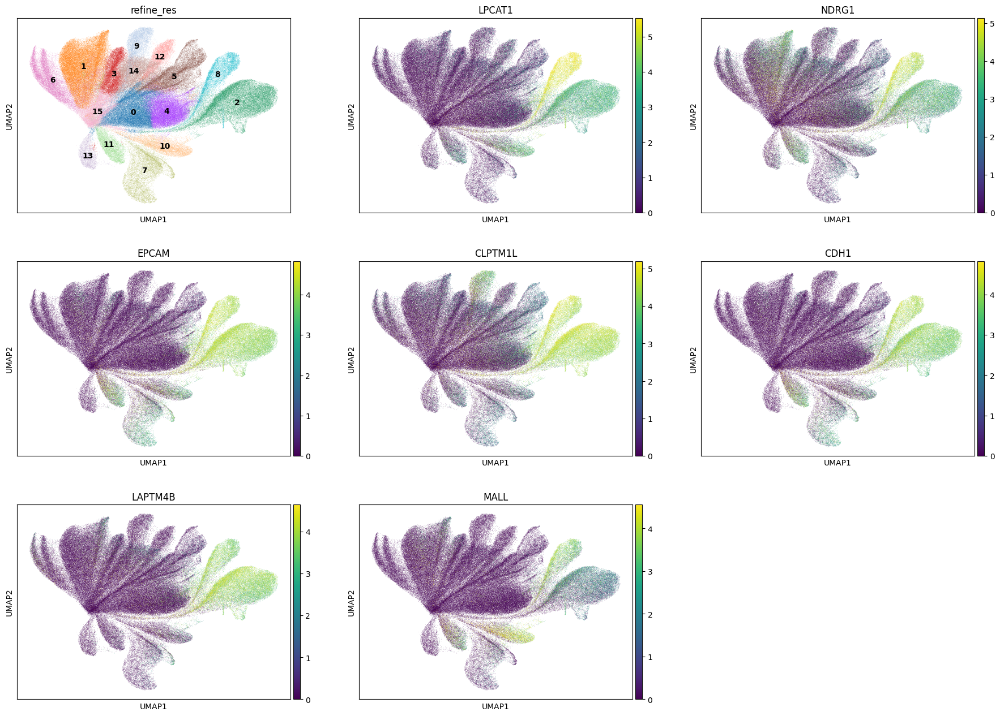

In [96]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [97]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 9635
Percentage of cells in cluster 8: 3.5


In [98]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeII_epithelial_cell'

### 5.10. Cluster 9

In [99]:
cluster_id = '9'

In [100]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Plasma,Plasma,normal_cell,84.5
1,Unknown,Unknown,normal_cell,5.5
2,T,T,normal_cell,2.7
3,Fibroblast,CAF,normal_cell,2.6
4,NA,NA,NA,1.9


In [101]:
top_ranked_genes[cluster_id]

0       XBP1
1       MZB1
2     TENT5C
3     SLAMF7
4      DERL3
5    POU2AF1
6       PIM2
Name: 9, dtype: object

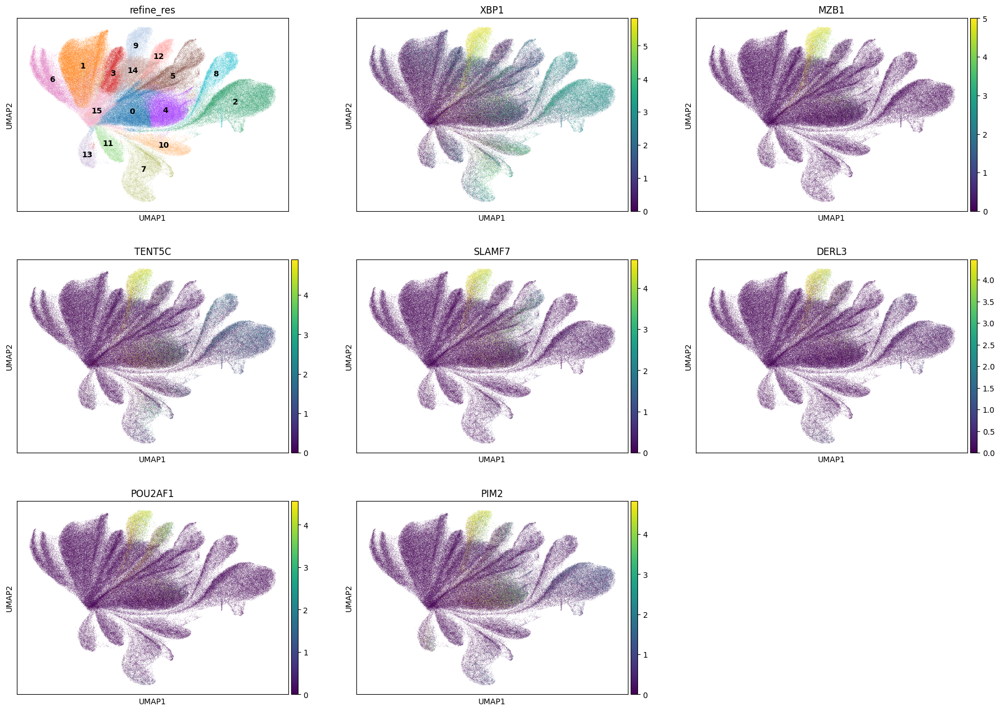

In [102]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [103]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 8875
Percentage of cells in cluster 9: 3.3


In [104]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.11. Cluster 10

In [105]:
cluster_id = '10'

In [106]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Lung_alveolar_typeII_epithelial_cell,cancer_cell,86.5
1,Endothelial,Endothelial,normal_cell,2.8
2,Unknown,Unknown,normal_cell,2.1
3,Epithelial,Lung_ciliated_epithelial_cell,normal_cell,2.0
4,Fibroblast,CAF,normal_cell,1.7


In [107]:
top_ranked_genes[cluster_id]

0      TCIM
1    DHCR24
2     ABCA3
3      SDC4
4     LAMP3
5    ATP1A1
6      MALL
Name: 10, dtype: object

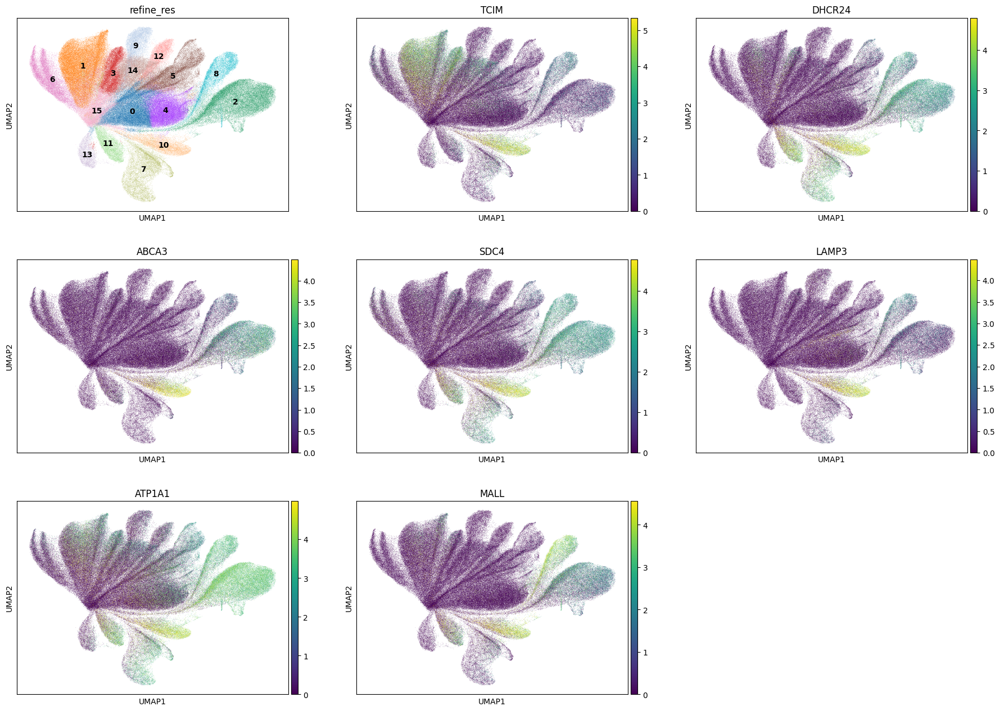

In [109]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [110]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 8365
Percentage of cells in cluster 10: 3.1


In [111]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeII_epithelial_cell'

### 5.12. Cluster 11

In [113]:
cluster_id = '11'

In [114]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Lung_alveolar_typeI_epithelial_cell,normal_cell,87.9
1,Endothelial,Endothelial,normal_cell,3.1
2,Fibroblast,CAF,normal_cell,2.3
3,Unknown,Unknown,normal_cell,2.1
4,NA,NA,NA,1.2


In [115]:
top_ranked_genes[cluster_id]

0      EMP2
1      AGER
2    CLDN18
3      NDNF
4      CD55
5     RTKN2
6     ANXA2
Name: 11, dtype: object

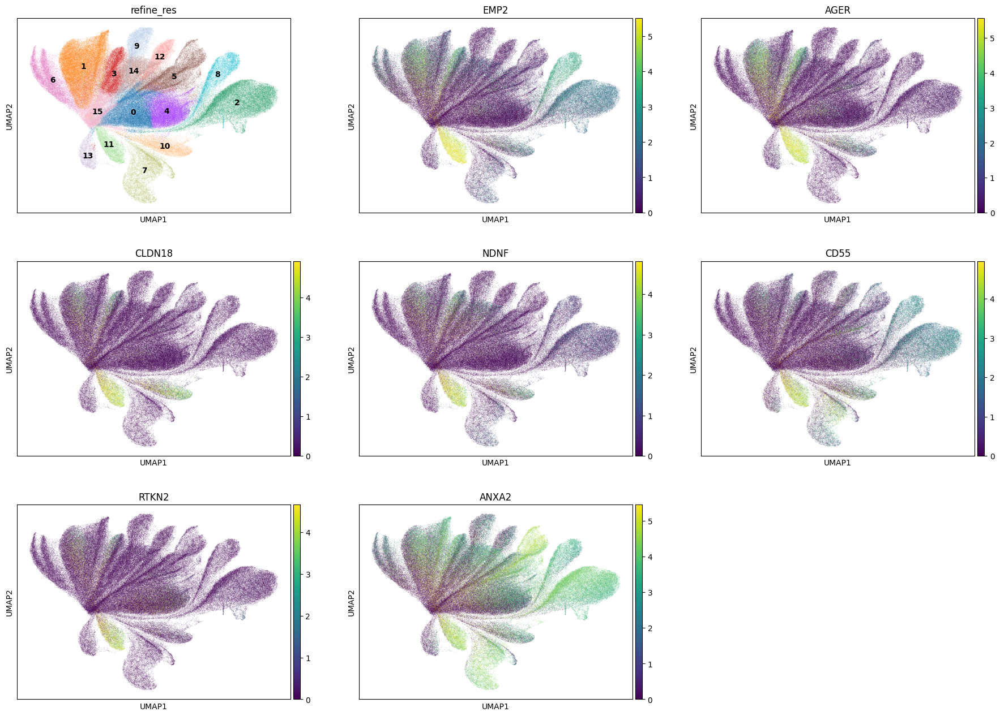

In [116]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [117]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 8101
Percentage of cells in cluster 11: 3.0


In [118]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Lung_alveolar_typeI_epithelial_cell'

### 5.13. Cluster 12

In [120]:
cluster_id = '12'

In [121]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,92.2
1,Unknown,Unknown,normal_cell,2.7
2,T,T,normal_cell,2.4
3,Plasma,Plasma,normal_cell,1.6
4,Fibroblast,CAF,normal_cell,0.5


In [122]:
top_ranked_genes[cluster_id]

0        MS4A1
1        CXCR4
2    TNFRSF13C
3        EEF1G
4         CD19
5        CD79A
6        BANK1
Name: 12, dtype: object

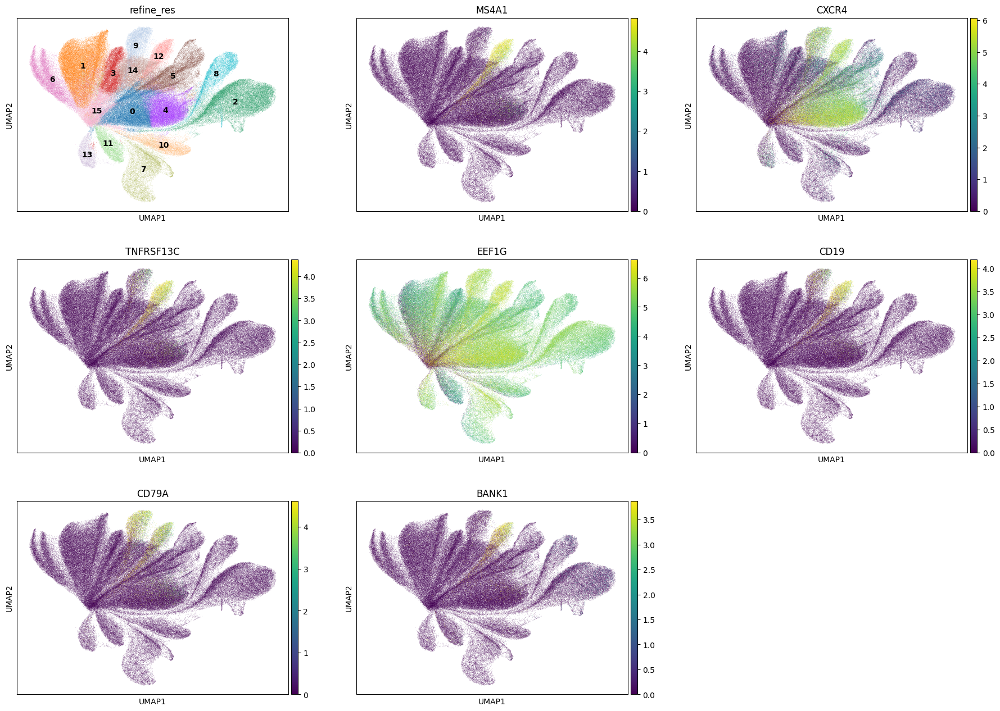

In [123]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [124]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 7170
Percentage of cells in cluster 12: 2.6


In [125]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.14. Cluster 13

In [127]:
cluster_id = '13'

In [128]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,90.7
1,Unknown,Unknown,normal_cell,2.9
2,NA,NA,NA,1.6
3,Fibroblast,CAF,normal_cell,1.4
4,T,T,normal_cell,0.7


In [129]:
top_ranked_genes[cluster_id]

0        KIT
1      GATA2
2        HDC
3      MS4A2
4    SLC18A2
5     IL1RL1
6       CD44
Name: 13, dtype: object

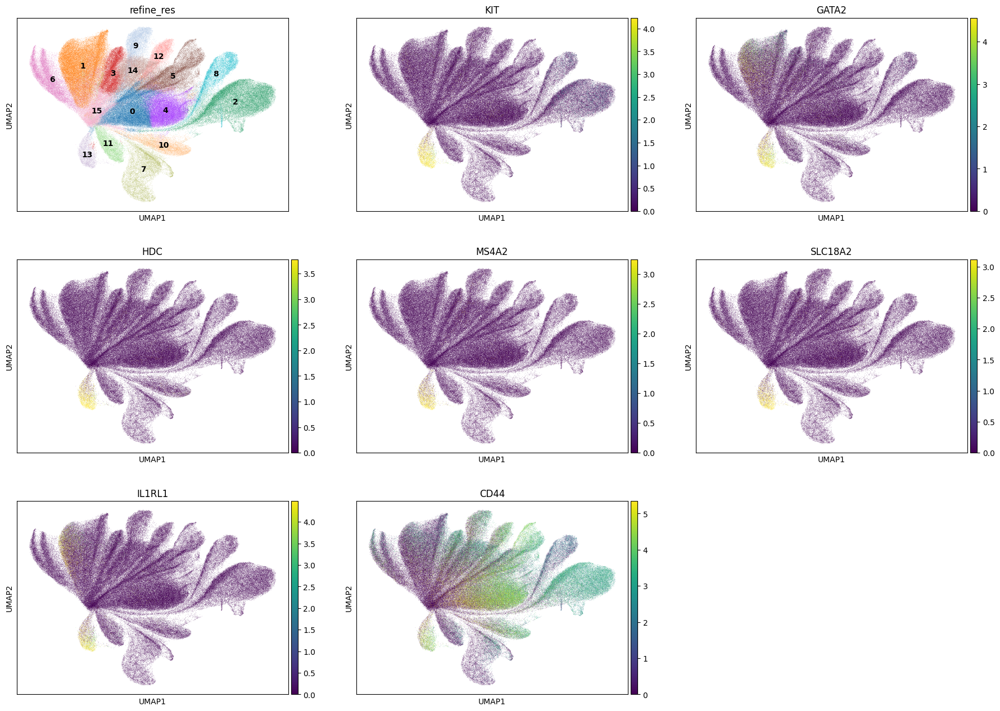

In [130]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [131]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 3600
Percentage of cells in cluster 13: 1.3


In [132]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.15. Cluster 14

In [133]:
cluster_id = '14'

In [134]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,86.4
1,T,T,normal_cell,2.8
2,Unknown,Unknown,normal_cell,2.7
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.5
4,Perivascular,Pericyte/Smooth_muscle,normal_cell,2.0


In [135]:
top_ranked_genes[cluster_id]

0     LTBP2
1    COL5A1
2      NBL1
3     AEBP1
4     CDH11
5     MMP14
6    CCDC80
Name: 14, dtype: object

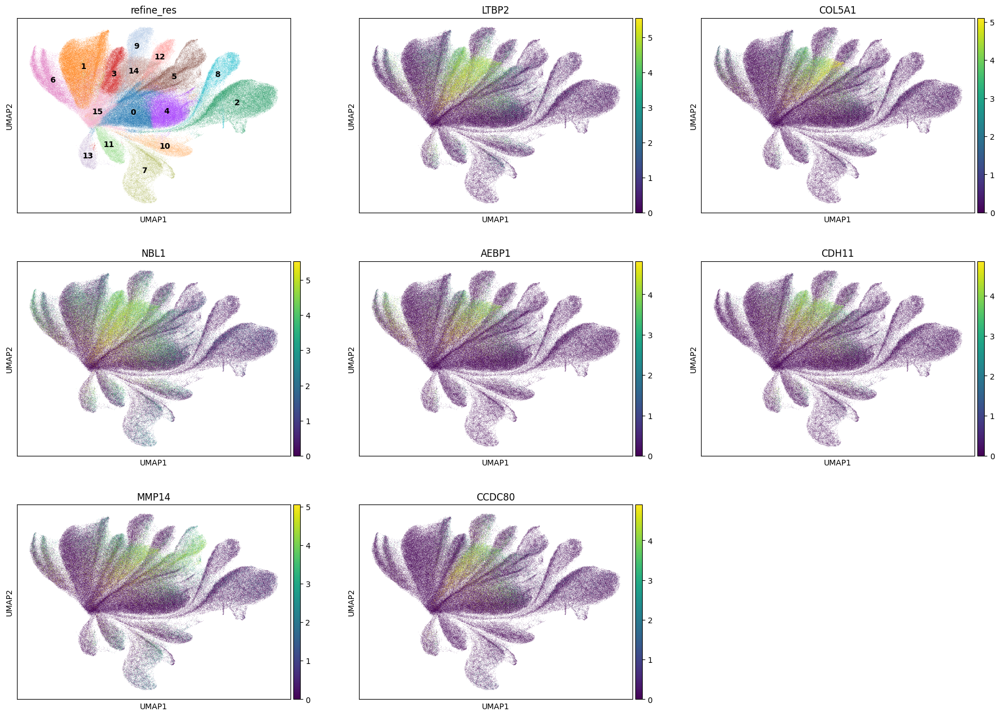

In [136]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [137]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 14: 13826
Percentage of cells in cluster 14: 5.1


In [138]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast/Myofibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.16. Cluster 15

In [141]:
cluster_id = '15'

In [142]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,43.1
1,NA,NA,NA,26.4
2,Fibroblast,CAF,normal_cell,16.6
3,Endothelial,Endothelial,normal_cell,4.0
4,Perivascular,Pericyte/Smooth_muscle,normal_cell,3.7


In [143]:
top_ranked_genes[cluster_id]

0    CXCR1
1     MGAM
2     FCAR
3    CXCR2
4     FPR1
5    PADI4
6     DUX4
Name: 15, dtype: object

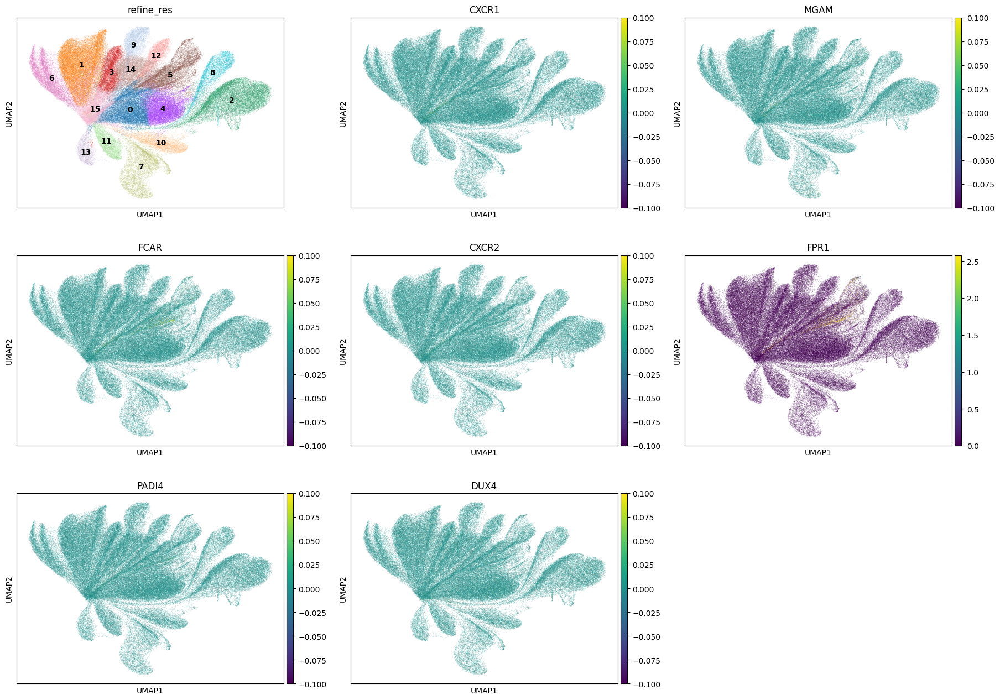

In [144]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [145]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 15: 17580
Percentage of cells in cluster 15: 6.5


In [146]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

## 6. Cancer cells

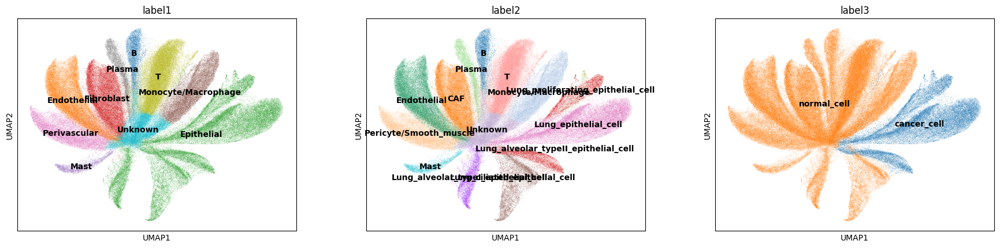

In [147]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

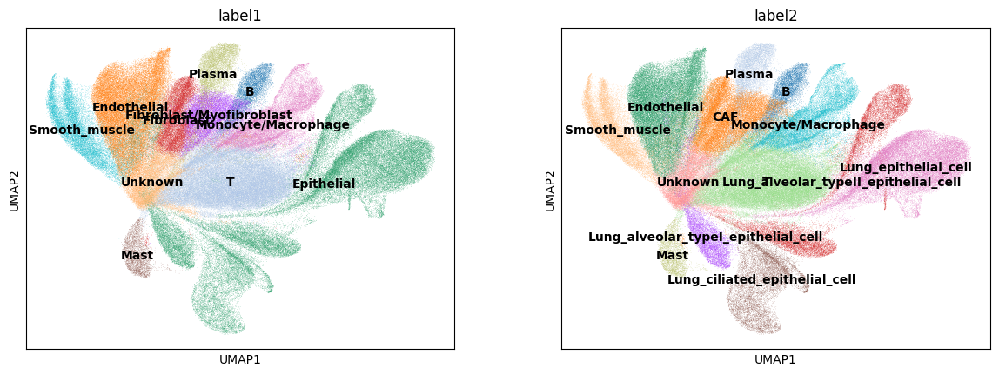

In [148]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [149]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label2'].isin(['Lung_epithelial_cell', 'Lung_alveolar_typeII_epithelial_cell']), 'label3'] = 'cancer_cell'

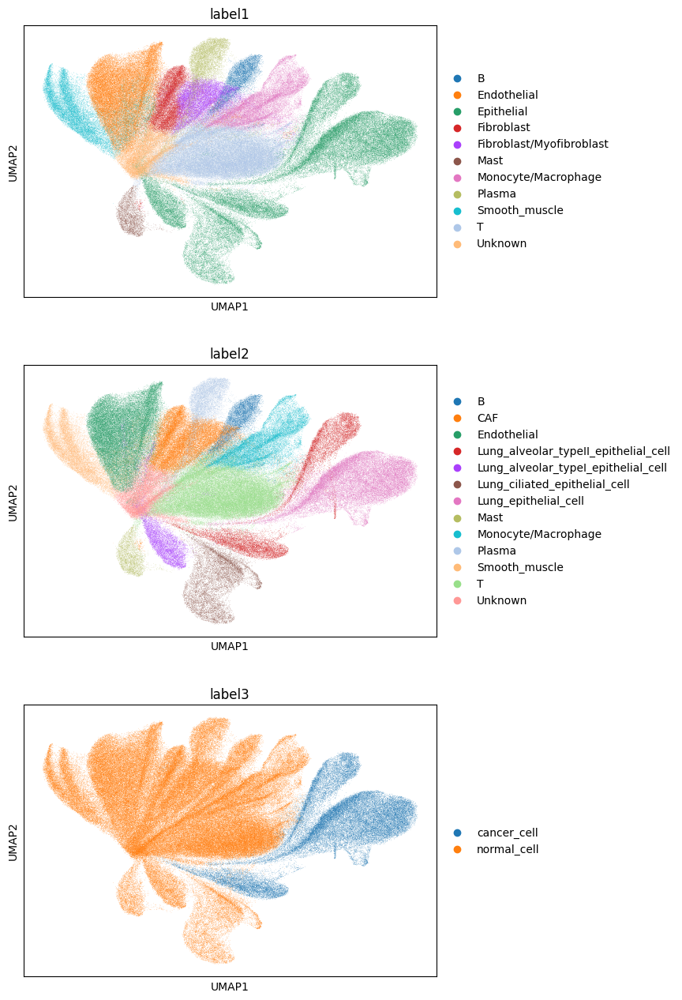

In [150]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [151]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n10_pcs20_leiden_res0.2,pca_n10_pcs20_leiden_res0.4,pca_n10_pcs20_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,226,0,0,0,0,0,226,44.659533,21.223438,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,4,4,4,T,T,normal_cell
1,aaaaaaab-1,108,0,0,0,0,0,108,32.196407,9.889219,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,0,3,0,T,T,normal_cell
2,aaaaaaac-1,265,0,0,0,0,3,268,47.504377,25.739063,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,4,4,4,T,T,normal_cell
3,aaaaaaad-1,328,0,0,0,0,1,329,37.253908,20.636407,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,4,4,4,T,T,normal_cell
4,aaaaaaae-1,337,0,0,0,0,0,337,52.155471,27.274376,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,4,4,4,T,T,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
278322,aaaeddab-1,118,0,0,0,0,0,118,96.634379,4.605938,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,13,16,18,13,Mast,Mast,normal_cell
278323,aaaeddac-1,76,0,0,0,0,0,76,41.001876,41.001876,...,Segmented by nucleus expansion of 5.0µm,cell_labels,7.0,0,0,6,15,Unknown,Unknown,normal_cell
278324,aaaeddad-1,12,0,0,0,0,0,12,26.416407,26.416407,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,0,0,6,15,Unknown,Unknown,normal_cell
278325,aaaeddae-1,73,0,0,0,0,1,74,37.976408,27.545313,...,Segmented by nucleus expansion of 5.0µm,cell_labels,6.0,0,0,6,15,Unknown,Unknown,normal_cell


In [152]:
adata_cells.write_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/DD_FGS/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")